# Reference Datasets

I am using this notebook to validate my ResNet18 implementation against some tfds datasets.

In [1]:
%pip install tensorflow --quiet
%pip install tensorflow-datasets --quiet
%pip install matplotlib --quiet


[notice] A new release of pip is available: 23.2.1 -> 23.3.2
[notice] To update, run: python3.10 -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.

[notice] A new release of pip is available: 23.2.1 -> 23.3.2
[notice] To update, run: python3.10 -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.

[notice] A new release of pip is available: 23.2.1 -> 23.3.2
[notice] To update, run: python3.10 -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [2]:
from resnet18 import *
import tensorflow_datasets as tfds

/opt/homebrew/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


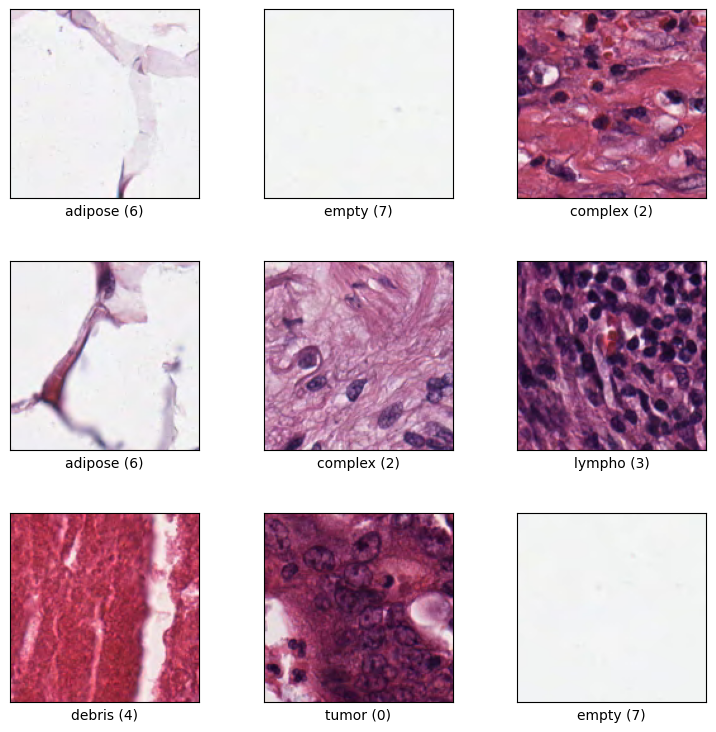

In [8]:
import matplotlib
ds, info = tfds.load('colorectal_histology', split='train', shuffle_files=True, with_info=True)
fig = tfds.show_examples(ds, info)
ds = ds.take(100)

In [9]:
# batch_size = 100
# image, label = tfds.as_numpy(tfds.load(
#     'colorectal_histology',
#     split='train',
#     batch_size=-1,
#     as_supervised=True,
# ))

In [10]:
my_resnet = ResNet18(n_classes=8)
input = tf.random.uniform((1, 64, 64, 3))
target = tf.Variable([0, 0, 1, 0], dtype=tf.float32)

optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)

# Training loop
# Reshape inputs
# print(image.shape)
# image = tf.cast(image, dtype=tf.float32)
# label = tf.cast(item["label"], dtype=tf.float32)
epochs = 11
left_cur = 0
losses = []

for epoch in range(epochs):
    for item in ds:
        image = tf.cast(item["image"], dtype=tf.float32)
        image = tf.reshape(image, shape=((1,) + image.shape))
        label = tf.reshape(tf.one_hot(item["label"], 8), shape=(1,8))
        label = tf.cast(label, dtype=tf.float32)
        print(label.shape)
        print(label)
        print(item["label"])
        # # batch = tf.reshape(image[left_cur:batch_cur], shape=((1,) + image[left_cur:batch_cur].shape))
        # # labels = label[left_cur:batch_cur]
        # # batch = tf.cast(batch, dtype=tf.float32)
        # # labels = tf.cast(labels, dtype=tf.float32)
        loss = train_step(my_resnet, image, label, optimizer)
        losses.append(loss.numpy())
        print(f"Epoch {epoch + 1}/{epochs}, Loss: {loss.numpy()}")

# Create a checkpoint
finish_point = tf.train.Checkpoint(model=my_resnet)
finish_point.save('./colorectal_resnet18model')

/opt/homebrew/lib/python3.10/site-packages/keras/src/initializers/initializers.py:120: UserWarning: The initializer RandomNormal is unseeded and being called multiple times, which will return identical values each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initializer instance more than once.
  warnings.warn(


(1, 8)
tf.Tensor([[0. 0. 0. 0. 0. 0. 1. 0.]], shape=(1, 8), dtype=float32)
tf.Tensor(6, shape=(), dtype=int64)
Original x: [[[[238. 211. 226.]
   [232. 205. 220.]
   [233. 210. 230.]
   ...
   [242. 242. 240.]
   [242. 241. 239.]
   [244. 243. 241.]]

  [[225. 213. 223.]
   [223. 211. 221.]
   [225. 208. 216.]
   ...
   [243. 242. 240.]
   [243. 242. 240.]
   [244. 243. 241.]]

  [[225. 209. 222.]
   [228. 212. 225.]
   [230. 214. 224.]
   ...
   [243. 242. 240.]
   [243. 242. 240.]
   [244. 243. 241.]]

  ...

  [[239. 243. 244.]
   [239. 243. 244.]
   [239. 243. 244.]
   ...
   [241. 241. 241.]
   [240. 242. 241.]
   [240. 242. 241.]]

  [[239. 243. 244.]
   [239. 243. 244.]
   [239. 243. 244.]
   ...
   [241. 241. 241.]
   [240. 242. 241.]
   [240. 242. 241.]]

  [[239. 243. 244.]
   [239. 243. 244.]
   [239. 243. 244.]
   ...
   [241. 241. 241.]
   [240. 242. 241.]
   [240. 242. 241.]]]]
Normalized x: [[[[0.93333334 0.827451   0.8862745 ]
   [0.9098039  0.8039216  0.8627451 ]
   [0

'./colorectal_resnet18model-1'

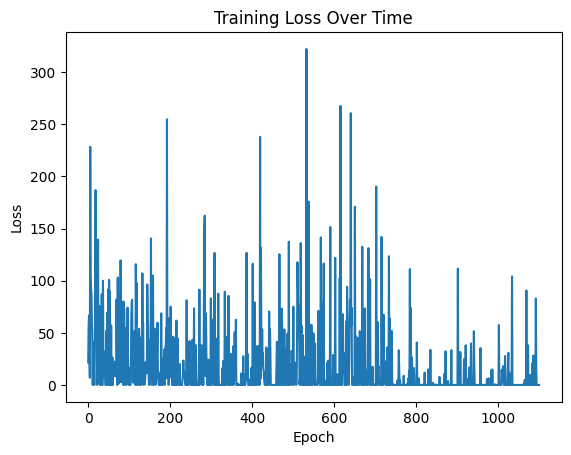

In [11]:
import matplotlib.pyplot as plt
plt.title("Training Loss Over Time")
plt.ylabel("Loss")
plt.xlabel("Epoch")
plt.plot(losses)

In [ ]:
%pip install pandas --quiet
%pip install jinja2 --quiet


[notice] A new release of pip is available: 23.2.1 -> 23.3.2
[notice] To update, run: python3.10 -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.

[notice] A new release of pip is available: 23.2.1 -> 23.3.2
[notice] To update, run: python3.10 -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


2024-01-26 18:46:17.761140: W tensorflow/core/kernels/data/cache_dataset_ops.cc:858] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


,filename,image,label
0,160F4_CRC-Prim-HE-08_021.tif_Row_1201_Col_1651.tif,,4 (debris)
1,143B2_CRC-Prim-HE-03_006.tif_Row_301_Col_1051.tif,,5 (mucosa)
2,153A0_CRC-Prim-HE-09_001.tif_Row_2401_Col_751.tif,,5 (mucosa)
3,12F96_CRC-Prim-HE-02_025.tif_Row_151_Col_601.tif,,0 (tumor)

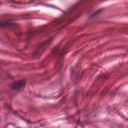
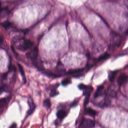
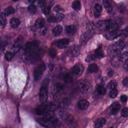
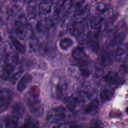

In [ ]:
import pandas as pd
from IPython.display import display

ds, info = tfds.load('colorectal_histology', split='train', with_info=True)
df = tfds.as_dataframe(ds.take(4), info)
display(df)


In [ ]:
# Spotchecking some predictions of tissues
import tensorflow as tf
import numpy as np
eg_image = df.iloc[2]
label = eg_image['label']
print(f"TRUE LABEL OF IMAGE IS {label}")
image = tf.reshape(eg_image["image"], shape=((1,) + eg_image["image"].shape))
predictions = np.argmax(tf.nn.softmax(my_resnet(image)))
print(f"PREDICTION IS {predictions}")

TRUE LABEL OF IMAGE IS 5
Original x: [[[[118  51 102]
   [122  55 106]
   [120  48  98]
   ...
   [141  98 141]
   [139  88 139]
   [148  97 148]]

  [[127  59 108]
   [131  63 112]
   [135  63 113]
   ...
   [131  85 130]
   [128  82 131]
   [129  83 132]]

  [[126  58 109]
   [128  60 111]
   [135  61 112]
   ...
   [143  89 141]
   [130  88 138]
   [114  72 122]]

  ...

  [[145  81 132]
   [129  65 116]
   [135  66 119]
   ...
   [166  96 141]
   [174 113 163]
   [200 139 189]]

  [[131  70 122]
   [118  57 109]
   [118  55 108]
   ...
   [186 122 172]
   [196 146 183]
   [215 165 202]]

  [[115  61 111]
   [112  58 108]
   [110  51 105]
   ...
   [202 144 192]
   [192 150 174]
   [208 166 190]]]]
Normalized x: [[[[0.4627451  0.2        0.4       ]
   [0.47843137 0.21568628 0.41568628]
   [0.47058824 0.1882353  0.38431373]
   ...
   [0.5529412  0.38431373 0.5529412 ]
   [0.54509807 0.34509805 0.54509807]
   [0.5803922  0.38039216 0.5803922 ]]

  [[0.49803922 0.23137255 0.42352942]


In [ ]:
# Testing accuracy against the whole dataset
# Will need to modify training step to actually do a train/test split
# but can do this later



TRUE LABEL OF IMAGE IS 5
Original x: [[[[106  47  87]
   [128  69 109]
   [135  72 114]
   ...
   [161  89 139]
   [135  81 131]
   [121  67 117]]

  [[ 91  35  83]
   [115  59 107]
   [126  63 114]
   ...
   [153  93 141]
   [143  86 137]
   [132  75 126]]

  [[ 69  30  71]
   [ 87  48  89]
   [119  52 103]
   ...
   [146  88 139]
   [152  95 148]
   [142  85 138]]

  ...

  [[230 232 229]
   [235 237 234]
   [237 231 241]
   ...
   [207 183 207]
   [198 171 204]
   [176 149 182]]

  [[231 231 231]
   [237 237 237]
   [238 233 239]
   ...
   [212 186 213]
   [201 174 205]
   [178 151 182]]

  [[234 232 237]
   [237 235 240]
   [238 233 237]
   ...
   [220 192 217]
   [206 177 207]
   [184 155 185]]]]
Normalized x: [[[[0.41568628 0.18431373 0.34117648]
   [0.5019608  0.27058825 0.42745098]
   [0.5294118  0.28235295 0.44705883]
   ...
   [0.6313726  0.34901962 0.54509807]
   [0.5294118  0.31764707 0.5137255 ]
   [0.4745098  0.2627451  0.45882353]]

  [[0.35686275 0.13725491 0.3254902 ]


In [ ]:
ds, info = tfds.load('colorectal_histology', split='train', shuffle_files=True, with_info=True)
ds = ds.take(100)
true_positives = 0
n_predictions = 0
for item in ds:
    image = tf.cast(item["image"], dtype=tf.float32)
    image = tf.reshape(image, shape=((1,) + image.shape))
    label = item["label"]
    print(label)
    prediction = np.argmax(tf.nn.softmax(my_resnet(image)))
    if prediction == label:
        true_positives += 1
    
    n_predictions += 1

tf.Tensor(6, shape=(), dtype=int64)
Original x: [[[[238. 211. 226.]
   [232. 205. 220.]
   [233. 210. 230.]
   ...
   [242. 242. 240.]
   [242. 241. 239.]
   [244. 243. 241.]]

  [[225. 213. 223.]
   [223. 211. 221.]
   [225. 208. 216.]
   ...
   [243. 242. 240.]
   [243. 242. 240.]
   [244. 243. 241.]]

  [[225. 209. 222.]
   [228. 212. 225.]
   [230. 214. 224.]
   ...
   [243. 242. 240.]
   [243. 242. 240.]
   [244. 243. 241.]]

  ...

  [[239. 243. 244.]
   [239. 243. 244.]
   [239. 243. 244.]
   ...
   [241. 241. 241.]
   [240. 242. 241.]
   [240. 242. 241.]]

  [[239. 243. 244.]
   [239. 243. 244.]
   [239. 243. 244.]
   ...
   [241. 241. 241.]
   [240. 242. 241.]
   [240. 242. 241.]]

  [[239. 243. 244.]
   [239. 243. 244.]
   [239. 243. 244.]
   ...
   [241. 241. 241.]
   [240. 242. 241.]
   [240. 242. 241.]]]]
Normalized x: [[[[0.93333334 0.827451   0.8862745 ]
   [0.9098039  0.8039216  0.8627451 ]
   [0.9137255  0.8235294  0.9019608 ]
   ...
   [0.9490196  0.9490196  0.9411765

In [ ]:
print(f"Accuracy is {true_positives / n_predictions}")

Accuracy is 0.6
